<a href="https://colab.research.google.com/github/shankch/reverse-image/blob/main/feature_extract_knn_cluster_plot.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Feature Extraction

We will extract features from pretrained models like VGG-16, VGG-19, ResNet-50, InceptionV3 and MobileNet and benchmark them using the udset dataset.

## Dataset:

UC Merced Land Use Dataset

This is a 21 class land use image dataset meant for research purposes.

There are 100 images for each class.

Each image measures 256x256 pixels.

The images were manually extracted from large images from the USGS National Map Urban Area Imagery collection for various urban areas around the country. The pixel resolution of this public domain imagery is 1 foot.

Credits for Dataset Curation:
Yi Yang and Shawn Newsam, "Bag-Of-Visual-Words and Spatial Extensions for Land-Use Classification," ACM SIGSPATIAL International Conference on Advances in Geographic Information Systems (ACM GIS), 2010.


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
!pip3 install sklearn
!mkdir -p ../../datasets
!pip install gdown
!gdown http://weegee.vision.ucmerced.edu/datasets/UCMerced_LandUse.zip --output ../../datasets/UCMerced_LandUse.zip
!unzip ../../datasets/UCMerced_LandUse.zip -d ../../datasets/
!mv ../../datasets/UCMerced_LandUse/Images ../../datasets/udset

In [38]:
import numpy as np
from numpy.linalg import norm
import pickle
from tqdm import tqdm, tqdm_notebook
import os
import random
import time
import math
import tensorflow
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications.resnet50 import ResNet50, preprocess_input
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.applications.vgg19 import VGG19
from tensorflow.keras.applications.mobilenet import MobileNet
from tensorflow.keras.applications.inception_v3 import InceptionV3
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Flatten, Dense, Dropout, GlobalAveragePooling2D
import numpy as np
import pickle
from tqdm import tqdm, tqdm_notebook
import random
import time
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
import PIL
from PIL import Image
from sklearn.neighbors import NearestNeighbors

import glob
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline


We will define a helper function that allows us to choose any pretrained model with all the necessary details for our experiments.

In [39]:
def model_picker(name):
    if (name == 'vgg16'):
        model = VGG16(weights='imagenet',
                      include_top=False,
                      input_shape=(224, 224, 3),
                      pooling='max')
    elif (name == 'vgg19'):
        model = VGG19(weights='imagenet',
                      include_top=False,
                      input_shape=(224, 224, 3),
                      pooling='max')
    elif (name == 'mobilenet'):
        model = MobileNet(weights='imagenet',
                          include_top=False,
                          input_shape=(224, 224, 3),
                          pooling='max',
                          depth_multiplier=1,
                          alpha=1)
    elif (name == 'inception'):
        model = InceptionV3(weights='imagenet',
                            include_top=False,
                            input_shape=(224, 224, 3),
                            pooling='max')
    elif (name == 'resnet'):
        model = ResNet50(weights='imagenet',
                         include_top=False,
                         input_shape=(224, 224, 3),
                         pooling='max')
    elif (name == 'xception'):
        model = Xception(weights='imagenet',
                         include_top=False,
                         input_shape=(224, 224, 3),
                         pooling='max')
    else:
        print("Specified model not available")
    return model

Now, let's put our function to use.

In [ ]:
model_architecture = 'resnet'
model = model_picker(model_architecture)

Let's define a function to extract image features given an image and a model.

In [41]:
def extract_features(img_path, model):
    input_shape = (224, 224, 3)
    img = image.load_img(img_path,
                         target_size=(input_shape[0], input_shape[1]))
    img_array = image.img_to_array(img)
    expanded_img_array = np.expand_dims(img_array, axis=0)
    preprocessed_img = preprocess_input(expanded_img_array)
    features = model.predict(preprocessed_img)
    flattened_features = features.flatten()
    normalized_features = flattened_features / norm(flattened_features)
    return normalized_features

The time taken to extract features is dependent on a few factors such as image size, computing power etc. A better benchmark would be running the network over an entire dataset. A simple change to the existing code will allow this.

Let's make a handy function to recursively get all the image files under a root directory.

In [42]:
extensions = ['.jpg', '.JPG', '.jpeg', '.JPEG', '.png', '.PNG', '.tif', '.TIF']

def get_file_list(root_dir):
    file_list = []
    for root, directories, filenames in os.walk(root_dir):
        for filename in filenames:
            if any(ext in filename for ext in extensions):
                file_list.append(os.path.join(root, filename))
    return file_list

Now, let's run the extraction over the entire dataset and time it.

In [43]:
# path to the your datasets
root_dir = '../../datasets/udset'
filenames = sorted(get_file_list(root_dir))

feature_list = []
for i in tqdm_notebook(range(len(filenames))):
    feature_list.append(extract_features(filenames[i], model))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  


  0%|          | 0/2100 [00:00<?, ?it/s]

Now let's try the same with the Keras Image Generator functions.

In [ ]:
batch_size = 64
datagen = tensorflow.keras.preprocessing.image.ImageDataGenerator(preprocessing_function=preprocess_input)

generator = datagen.flow_from_directory(root_dir,
                                        target_size=(224, 224),
                                        batch_size=batch_size,
                                        class_mode=None,
                                        shuffle=False)

num_images = len(generator.filenames)
num_epochs = int(math.ceil(num_images / batch_size))

start_time = time.time()
feature_list = []
feature_list = model.predict_generator(generator, num_epochs)
end_time = time.time()

In [46]:
for i, features in enumerate(feature_list):
    feature_list[i] = features / norm(features)

feature_list = feature_list.reshape(num_images, -1)

print("Num images   = ", len(generator.classes))
print("Shape of feature_list = ", feature_list.shape)
print("Time taken in sec = ", end_time - start_time)

Num images   =  2100
Shape of feature_list =  (2100, 2048)
Time taken in sec =  17.078817129135132


### Some benchmarks on different model architectures to see relative speeds

Keeping batch size of 64, benchmarking the different models

|Model |items/second |
|-|-|-|
| VGG19     | 31.06 |
| VGG16     | 28.16 | 
| Resnet50  | 28.48 | 
| Inception | 20.07 |
| Mobilenet | 13.45 |

Let's save the features as intermediate files to use later.

In [47]:
filenames = [root_dir + '/' + s for s in generator.filenames]

In [48]:
!mkdir data
pickle.dump(generator.classes, open('./data/class_ids-udset.pickle','wb'))
pickle.dump(filenames, open('./data/filenames-udset.pickle', 'wb'))
pickle.dump(
    feature_list,
    open('./data/features-udset-' + model_architecture + '.pickle', 'wb'))

Let's train a finetuned model as well and save the features for that as well.

In [50]:
TRAIN_SAMPLES = 2100
NUM_CLASSES = 21
IMG_WIDTH, IMG_HEIGHT = 256, 256

In [51]:
train_datagen = ImageDataGenerator(preprocessing_function=preprocess_input,
                                   rotation_range=20,
                                   width_shift_range=0.2,
                                   height_shift_range=0.2,
                                   zoom_range=0.2)

In [52]:
train_generator = train_datagen.flow_from_directory(root_dir,
                                                    target_size=(IMG_WIDTH,
                                                                 IMG_HEIGHT),
                                                    batch_size=batch_size,
                                                    shuffle=True,
                                                    seed=12345,
                                                    class_mode='categorical')

Found 2100 images belonging to 21 classes.


In [53]:
def model_maker():
    base_model = ResNet50(include_top=False,
                           input_shape=(IMG_WIDTH, IMG_HEIGHT, 3))
    for layer in base_model.layers[:]:
        layer.trainable = False
    input = Input(shape=(IMG_WIDTH, IMG_HEIGHT, 3))
    custom_model = base_model(input)
    custom_model = GlobalAveragePooling2D()(custom_model)
    custom_model = Dense(64, activation='relu')(custom_model)
    custom_model = Dropout(0.5)(custom_model)
    predictions = Dense(NUM_CLASSES, activation='softmax')(custom_model)
    return Model(inputs=input, outputs=predictions)

In [55]:
model_finetuned = model_maker()
model_finetuned.compile(loss='categorical_crossentropy',
              optimizer=tensorflow.keras.optimizers.Adam(0.001),
              metrics=['acc'])
model_finetuned.fit_generator(
    train_generator,
    steps_per_epoch=math.ceil(float(TRAIN_SAMPLES) / batch_size),
    epochs=20)

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:1972: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  warnings.warn('`Model.fit_generator` is deprecated and '


Epoch 1/15
33/33 [==============================] - 41s 1s/step - loss: 2.6315 - acc: 0.2181
Epoch 2/15
33/33 [==============================] - 37s 1s/step - loss: 1.5918 - acc: 0.5224
Epoch 3/15
33/33 [==============================] - 37s 1s/step - loss: 1.1521 - acc: 0.6548
Epoch 4/15
33/33 [==============================] - 37s 1s/step - loss: 0.9271 - acc: 0.7167
Epoch 5/15
33/33 [==============================] - 37s 1s/step - loss: 0.7853 - acc: 0.7657
Epoch 6/15
33/33 [==============================] - 37s 1s/step - loss: 0.7032 - acc: 0.7771
Epoch 7/15
33/33 [==============================] - 37s 1s/step - loss: 0.5950 - acc: 0.8200
Epoch 8/15
33/33 [==============================] - 37s 1s/step - loss: 0.5441 - acc: 0.8329
Epoch 9/15
33/33 [==============================] - 37s 1s/step - loss: 0.5110 - acc: 0.8395
Epoch 10/15
33/33 [==============================] - 37s 1s/step - loss: 0.4537 - acc: 0.8619
Epoch 11/15
33/33 [==============================] - 37s 1s/step - lo

In [56]:
model_finetuned.save('./data/model-finetuned.h5')

/usr/local/lib/python3.7/dist-packages/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


In [57]:
start_time = time.time()
feature_list_finetuned = []
feature_list_finetuned = model_finetuned.predict_generator(generator, num_epochs)
end_time = time.time()

for i, features_finetuned in enumerate(feature_list_finetuned):
    feature_list_finetuned[i] = features_finetuned / norm(features_finetuned)

feature_list = feature_list_finetuned.reshape(num_images, -1)

print("Num images   = ", len(generator.classes))
print("Shape of feature_list = ", feature_list.shape)
print("Time taken in sec = ", end_time - start_time)

/usr/local/lib/python3.7/dist-packages/keras/engine/training.py:2035: UserWarning: `Model.predict_generator` is deprecated and will be removed in a future version. Please use `Model.predict`, which supports generators.
  warnings.warn('`Model.predict_generator` is deprecated and '


Num images   =  2100
Shape of feature_list =  (2100, 21)
Time taken in sec =  14.097549200057983


In [58]:
pickle.dump(
    feature_list,
    open('./data/features-udset-resnet-finetuned.pickle', 'wb'))
print(feature_list)
print(type(feature_list))

[[9.7641397e-01 3.5833971e-05 4.7085955e-06 ... 2.9721517e-05
  6.9820121e-06 3.0152604e-04]
 [1.0000000e+00 1.2388163e-09 5.3070038e-11 ... 8.4742382e-09
  8.9096625e-10 1.4607714e-07]
 [9.9999905e-01 2.3186983e-08 7.6693991e-11 ... 1.2985742e-09
  9.4958850e-09 3.4263292e-07]
 ...
 [3.5579531e-03 3.1439953e-02 3.9805174e-03 ... 1.1162693e-01
  3.4532386e-03 7.0561039e-01]
 [5.8842124e-05 9.5200732e-05 2.1235999e-02 ... 2.3728173e-02
  8.7147048e-03 9.9920255e-01]
 [6.5908389e-06 1.3393913e-05 1.2495758e-03 ... 1.3050044e-02
  7.3922274e-05 9.9990714e-01]]
<class 'numpy.ndarray'>


In [59]:
!cp -a data/* drive/MyDrive/c99t1/    #saving to personal drive (do it if using colab to have a backup)

In [60]:
class_ids = generator.classes

# Similarity Search

We write an indexer to index features and search for most similar features using various nearest neighbor algorithms, and explore various methods of visualizing plots.


Here we visualize some query images represented by their standard features with their nearest neighbors

In [61]:
num_images = len(filenames)
num_features_per_image = len(feature_list[0])
print("Number of images = ", num_images)
print("Number of features per image = ", num_features_per_image)


Number of images =  2100
Number of features per image =  2048


In [63]:
neighbors = NearestNeighbors(n_neighbors=5,
                             algorithm='brute',
                             metric='euclidean').fit(feature_list)

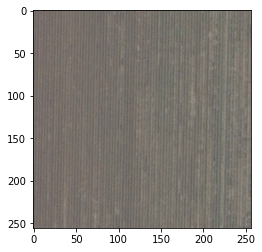

In [64]:
random_index = 75
distances, indices = neighbors.kneighbors([feature_list[random_index]])
plt.imshow(mpimg.imread(filenames[75]), interpolation='lanczos')

[[75 67 73 69 68]]


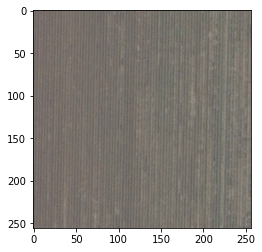

In [65]:
print(indices)
plt.imshow(mpimg.imread(filenames[indices[0][0]]), interpolation='lanczos')

The nearest index will be the image itself because that is what is being queried.

In [66]:
for i in range(5):
    print(distances[0][i])

0.0
0.5670229
0.5811793
0.59655106
0.61001337


In [67]:
# Helper function to get the classname
def classname(str):
    return str.split('/')[-2]


# Helper function to get the classname and filename
def classname_filename(str):
    return str.split('/')[-2] + '/' + str.split('/')[-1]


# Helper functions to plot the nearest images given a query image
def plot_images(filenames, distances):
    images = []
    for filename in filenames:
        images.append(mpimg.imread(filename))
    plt.figure(figsize=(20, 10))
    columns = 4
    for i, image in enumerate(images):
        ax = plt.subplot(len(images) / columns + 1, columns, i + 1)
        if i == 0:
            ax.set_title("Query Image\n" + classname_filename(filenames[i]))
        else:
            ax.set_title("Similar Image\n" + classname_filename(filenames[i]) +
                         "\nDistance: " +
                         str(float("{0:.2f}".format(distances[i]))))
        plt.imshow(image)
        # To save the plot in a high definition format i.e. PDF, uncomment the following line:
        #plt.savefig('results/' + str(random.randint(0,10000))+'.pdf', format='pdf', dpi=1000)

['../../datasets/udset/mobilehomepark/mobilehomepark57.tif', '../../datasets/udset/mobilehomepark/mobilehomepark60.tif', '../../datasets/udset/mobilehomepark/mobilehomepark46.tif', '../../datasets/udset/mobilehomepark/mobilehomepark44.tif']
['../../datasets/udset/overpass/overpass87.tif', '../../datasets/udset/intersection/intersection28.tif', '../../datasets/udset/overpass/overpass45.tif', '../../datasets/udset/buildings/buildings97.tif']
['../../datasets/udset/river/river42.tif', '../../datasets/udset/river/river52.tif', '../../datasets/udset/river/river48.tif', '../../datasets/udset/golfcourse/golfcourse86.tif']
['../../datasets/udset/buildings/buildings00.tif', '../../datasets/udset/denseresidential/denseresidential02.tif', '../../datasets/udset/intersection/intersection02.tif', '../../datasets/udset/denseresidential/denseresidential03.tif']
['../../datasets/udset/harbor/harbor74.tif', '../../datasets/udset/harbor/harbor73.tif', '../../datasets/udset/harbor/harbor79.tif', '../../da

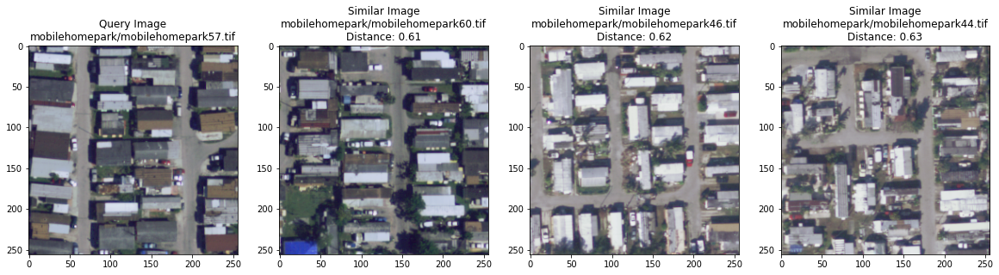

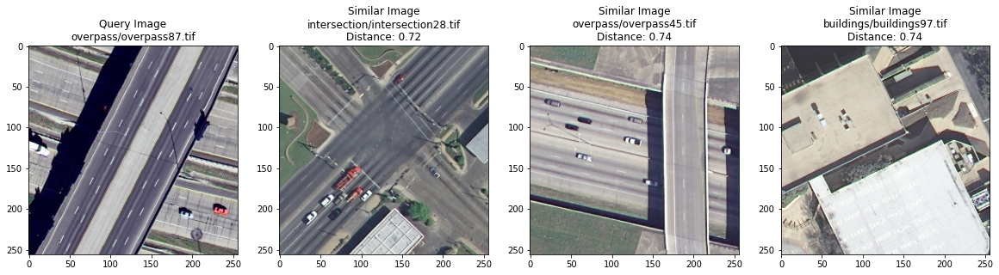

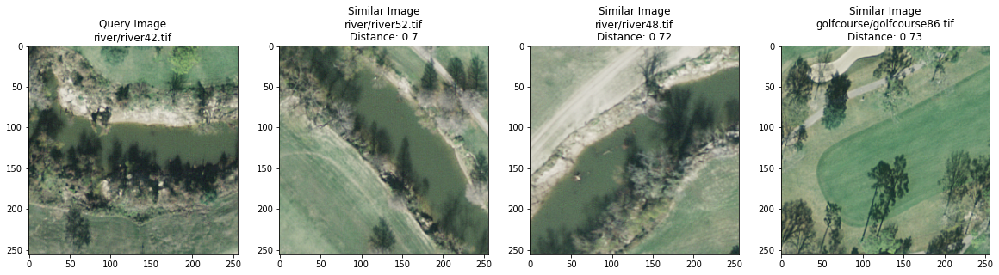

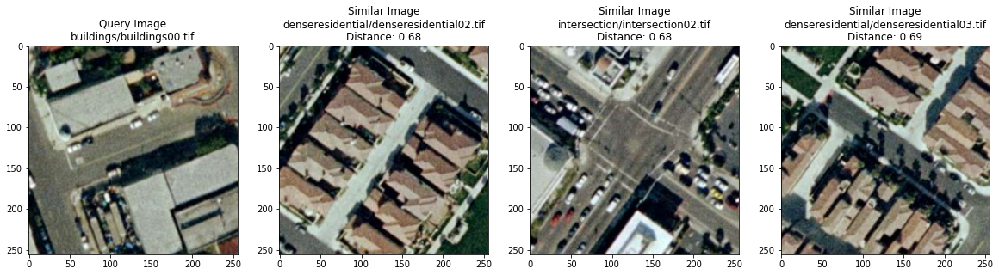

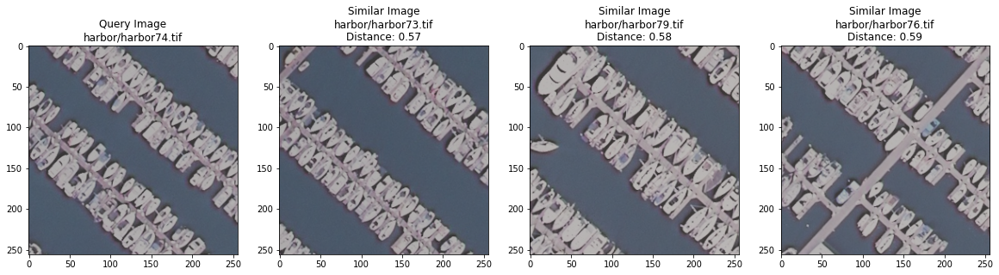

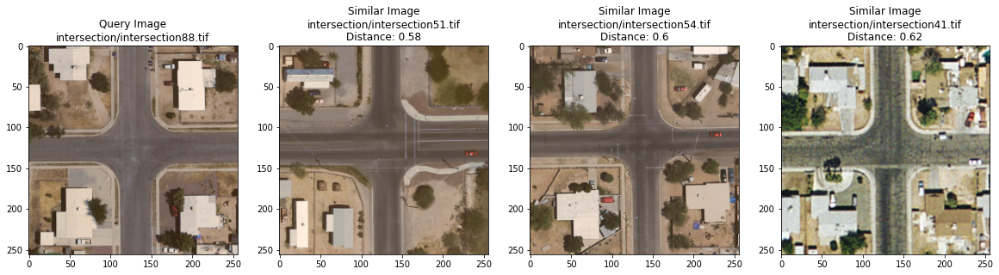

In [68]:
for i in range(6):
    random_image_index = random.randint(0, num_images)
    distances, indices = neighbors.kneighbors(
        [feature_list[random_image_index]])
    # Don't take the first closest image as it will be the same image
    similar_image_paths = [filenames[random_image_index]] + [filenames[indices[0][i]] for i in range(1, 4)]
    print(similar_image_paths)
    plot_images(similar_image_paths, distances[0])

In [69]:
neighbors = NearestNeighbors(n_neighbors=len(feature_list),
                             algorithm='brute',
                             metric='euclidean').fit(feature_list)
distances, indices = neighbors.kneighbors(feature_list)

# Calculating some stats
print (distances[:])
print(indices)
print("Median distance between all photos: ", np.median(distances))
print("Max distance between all photos: ", np.max(distances))


[[0.         0.8282448  0.82979727 ... 1.2039679  1.2132016  1.2145662 ]
 [0.         0.68639827 0.8039465  ... 1.2675189  1.2678529  1.2702215 ]
 [0.         0.4925771  0.81525475 ... 1.2516384  1.254908   1.257225  ]
 ...
 [0.         0.64815664 0.67657024 ... 1.223303   1.224232   1.2284946 ]
 [0.         0.6424607  0.68444604 ... 1.222584   1.222935   1.2246797 ]
 [0.         0.6424607  0.6712686  ... 1.225328   1.2269889  1.2319635 ]]
[[   0 1697  496 ...   31   26   10]
 [   1   13   95 ...  756  759  754]
 [   2    3    1 ...  735  754  756]
 ...
 [2097  687 1185 ...   26   10   94]
 [2098 2099 2031 ...   80   68   94]
 [2099 2098 2093 ...   62   15   89]]
Median distance between all photos:  0.9896282
Max distance between all photos:  1.3203944


In [83]:
print("Median distance among most similar photos: ",
      np.median(distances))

Median distance among most similar photos:  0.3654184


In [71]:
selected_features = feature_list[:]
selected_class_ids = class_ids[:]
selected_filenames = filenames[:]

In [72]:
n_components = 2
verbose = 1
perplexity = 30
n_iter = 1000
metric = 'euclidean'

time_start = time.time()
tsne_results = TSNE(n_components=n_components,
                    verbose=verbose,
                    perplexity=perplexity,
                    n_iter=n_iter,
                    metric=metric).fit_transform(selected_features)

print('t-SNE done! Time elapsed: {} seconds'.format(time.time() - time_start))

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2100 samples in 0.390s...
[t-SNE] Computed neighbors for 2100 samples in 17.983s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2100
[t-SNE] Computed conditional probabilities for sample 2000 / 2100
[t-SNE] Computed conditional probabilities for sample 2100 / 2100
[t-SNE] Mean sigma: 0.220386
[t-SNE] KL divergence after 250 iterations with early exaggeration: 71.337769
[t-SNE] KL divergence after 1000 iterations: 0.932983
t-SNE done! Time elapsed: 35.166263818740845 seconds


Plot a scatter plot from the generated t-SNE results

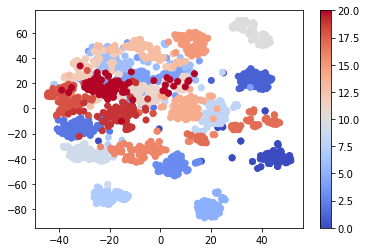

In [73]:
color_map = plt.cm.get_cmap('coolwarm')
scatter_plot = plt.scatter(tsne_results[:, 0],
                           tsne_results[:, 1],
                           c=selected_class_ids,
                           cmap=color_map)
plt.colorbar(scatter_plot)
plt.show()
# To save the plot in a high definition format i.e. PDF, uncomment the following line:
#plt.savefig('results/' + str(ADD_NAME_HERE)+'.pdf', format='pdf', dpi=1000)

Now we write a helper function to plot images in 2D for t-SNE.

In [74]:
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
from matplotlib.cbook import get_sample_data

def plot_images_in_2d(x, y, image_paths, axis=None, zoom=1):
    if axis is None:
        axis = plt.gca()
    x, y = np.atleast_1d(x, y)
    for x0, y0, image_path in zip(x, y, image_paths):
        image = Image.open(image_path)
        image.thumbnail((100, 100), Image.ANTIALIAS)
        img = OffsetImage(image, zoom=zoom)
        anno_box = AnnotationBbox(img, (x0, y0),
                                  xycoords='data',
                                  frameon=False)
        axis.add_artist(anno_box)
    axis.update_datalim(np.column_stack([x, y]))
    axis.autoscale()

In [75]:
def show_tsne(x, y, selected_filenames):
    fig, axis = plt.subplots()
    fig.set_size_inches(22, 22, forward=True)
    plot_images_in_2d(x, y, selected_filenames, zoom=0.3, axis=axis)
    plt.show()

Visualize the patterns in the images using t-SNE

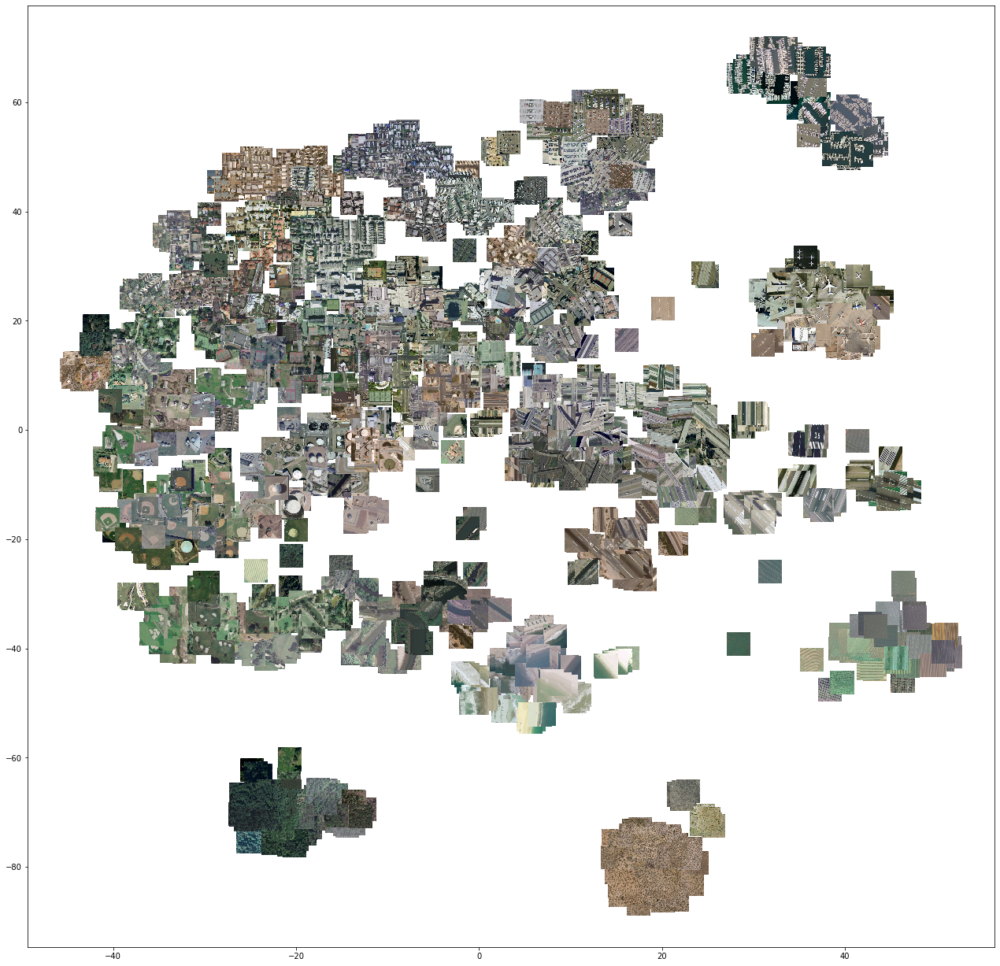

In [76]:
show_tsne(tsne_results[:, 0], tsne_results[:, 1], selected_filenames)

In [77]:
def tsne_to_grid_plotter_manual(x, y, selected_filenames):
    S = 2000
    s = 100
    x = (x - min(x)) / (max(x) - min(x))
    y = (y - min(y)) / (max(y) - min(y))
    x_values = []
    y_values = []
    filename_plot = []
    x_y_dict = {}
    for i, image_path in enumerate(selected_filenames):
        a = np.ceil(x[i] * (S - s))
        b = np.ceil(y[i] * (S - s))
        a = int(a - np.mod(a, s))
        b = int(b - np.mod(b, s))
        if str(a) + "|" + str(b) in x_y_dict:
            continue
        x_y_dict[str(a) + "|" + str(b)] = 1
        x_values.append(a)
        y_values.append(b)
        filename_plot.append(image_path)
    fig, axis = plt.subplots()
    fig.set_size_inches(22, 22, forward=True)
    plot_images_in_2d(x_values, y_values, filename_plot, zoom=.58, axis=axis)
    plt.show()

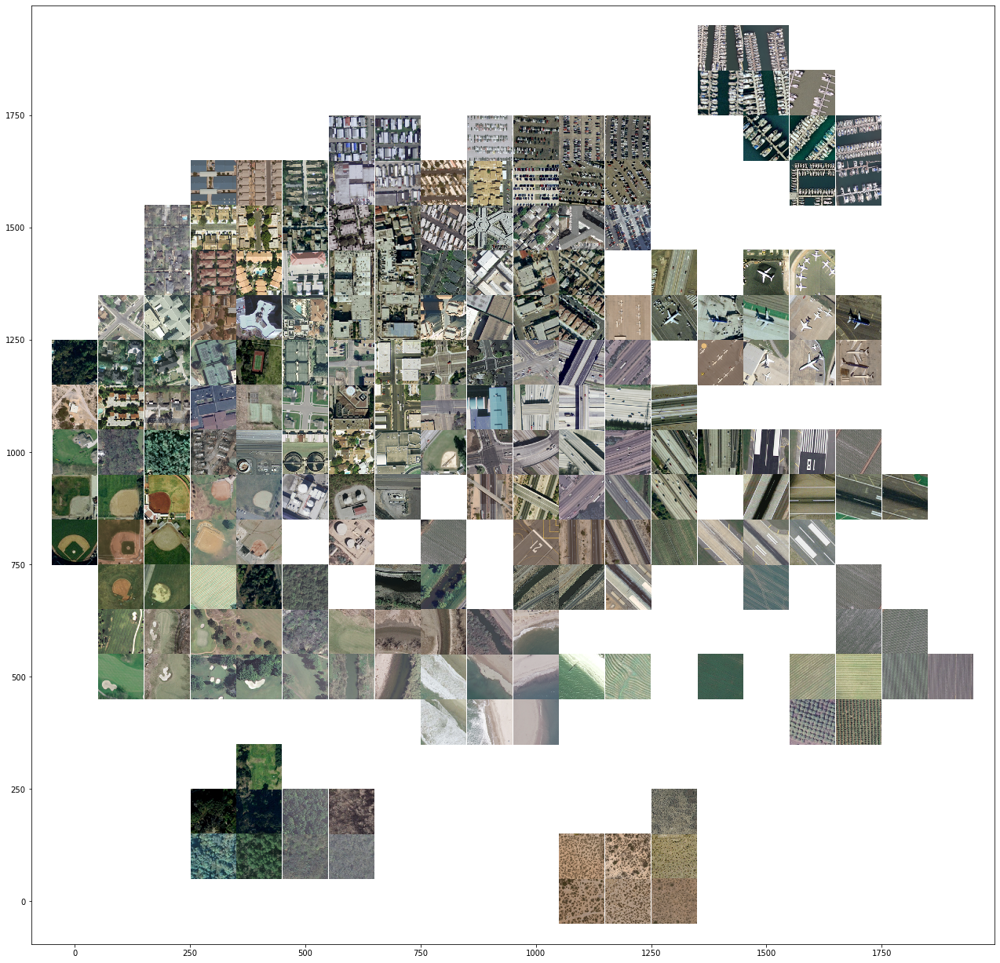

In [78]:
tsne_to_grid_plotter_manual(tsne_results[:, 0], tsne_results[:, 1], selected_filenames)

In [79]:
num_feature_dimensions = 100
pca = PCA(n_components=num_feature_dimensions)
pca.fit(feature_list)
feature_list_compressed = pca.transform(feature_list)
neighbors = NearestNeighbors(n_neighbors=5,
                             algorithm='brute',
                             metric='euclidean').fit(feature_list_compressed)
distances, indices = neighbors.kneighbors([feature_list_compressed[0]])

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2100 samples in 0.018s...
[t-SNE] Computed neighbors for 2100 samples in 0.925s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2100
[t-SNE] Computed conditional probabilities for sample 2000 / 2100
[t-SNE] Computed conditional probabilities for sample 2100 / 2100
[t-SNE] Mean sigma: 0.197954
[t-SNE] KL divergence after 250 iterations with early exaggeration: 70.971466
[t-SNE] KL divergence after 1000 iterations: 0.896691
t-SNE done! Time elapsed: 17.728737831115723 seconds


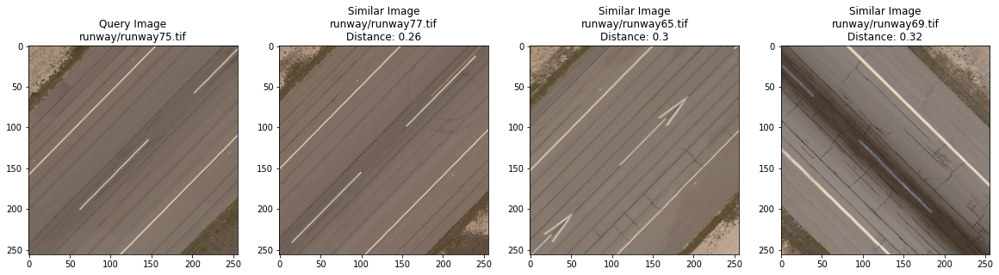

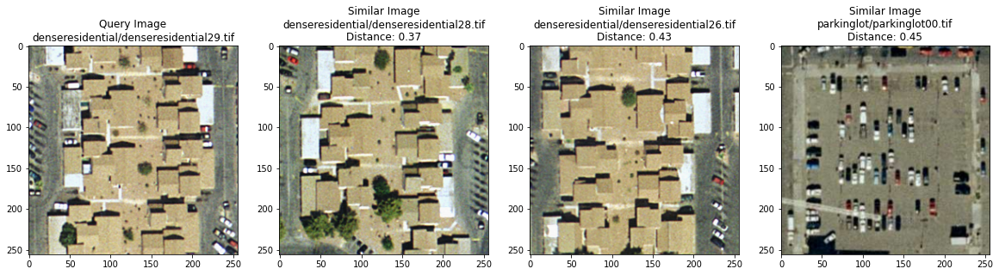

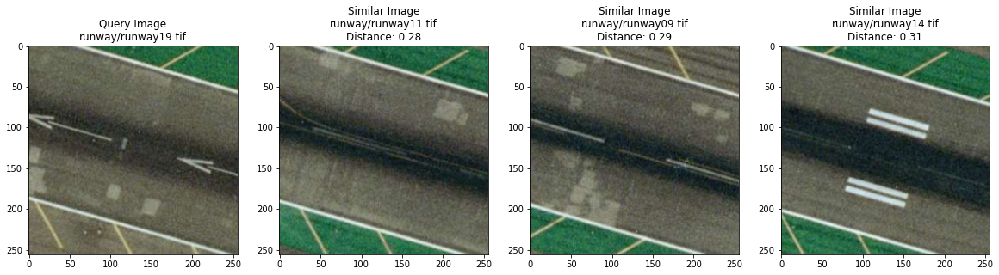

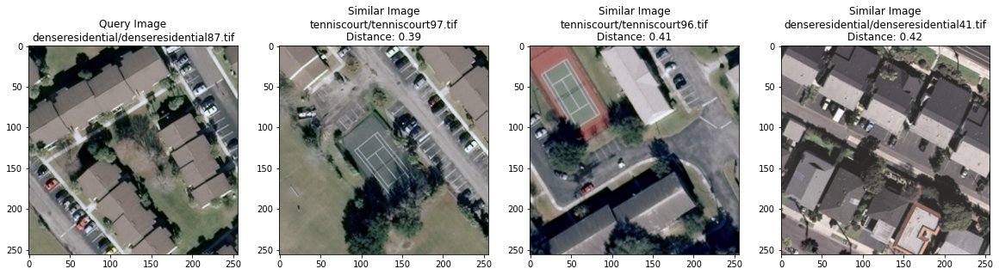

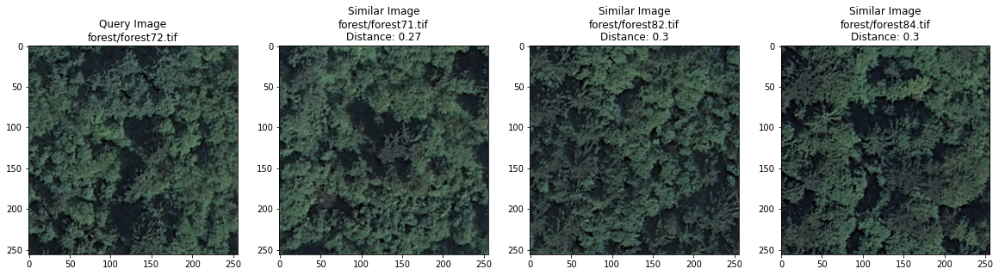

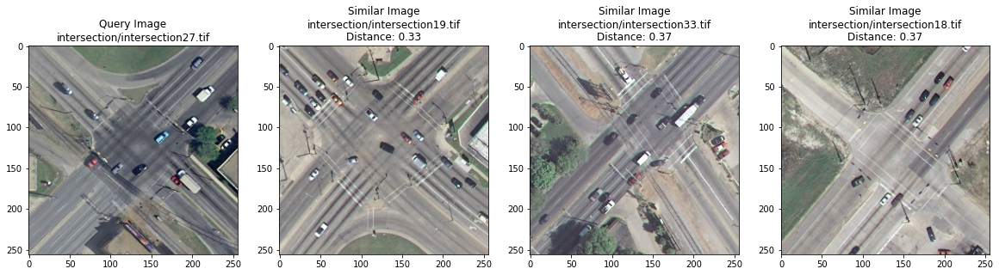

In [80]:
for i in range(6):
    random_image_index = random.randint(0, num_images)
    distances, indices = neighbors.kneighbors(
        [feature_list_compressed[random_image_index]])
    # Don't take the first closest image as it will be the same image
    similar_image_paths = [filenames[random_image_index]] + \
        [filenames[indices[0][i]] for i in range(1, 4)]
    plot_images(similar_image_paths, distances[0])
selected_features = feature_list_compressed[:]
selected_class_ids = class_ids[:]
selected_filenames = filenames[:]

time_start = time.time()
tsne_results = TSNE(n_components=2, verbose=1,
                    metric='euclidean').fit_transform(selected_features)
print('t-SNE done! Time elapsed: {} seconds'.format(time.time() - time_start))

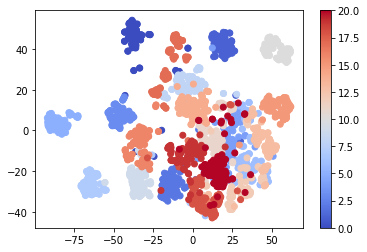

In [81]:
color_map = plt.cm.get_cmap('coolwarm')
scatter_plot = plt.scatter(tsne_results[:, 0],
                           tsne_results[:, 1],
                           c=selected_class_ids,
                           cmap=color_map)
plt.colorbar(scatter_plot)
plt.show()

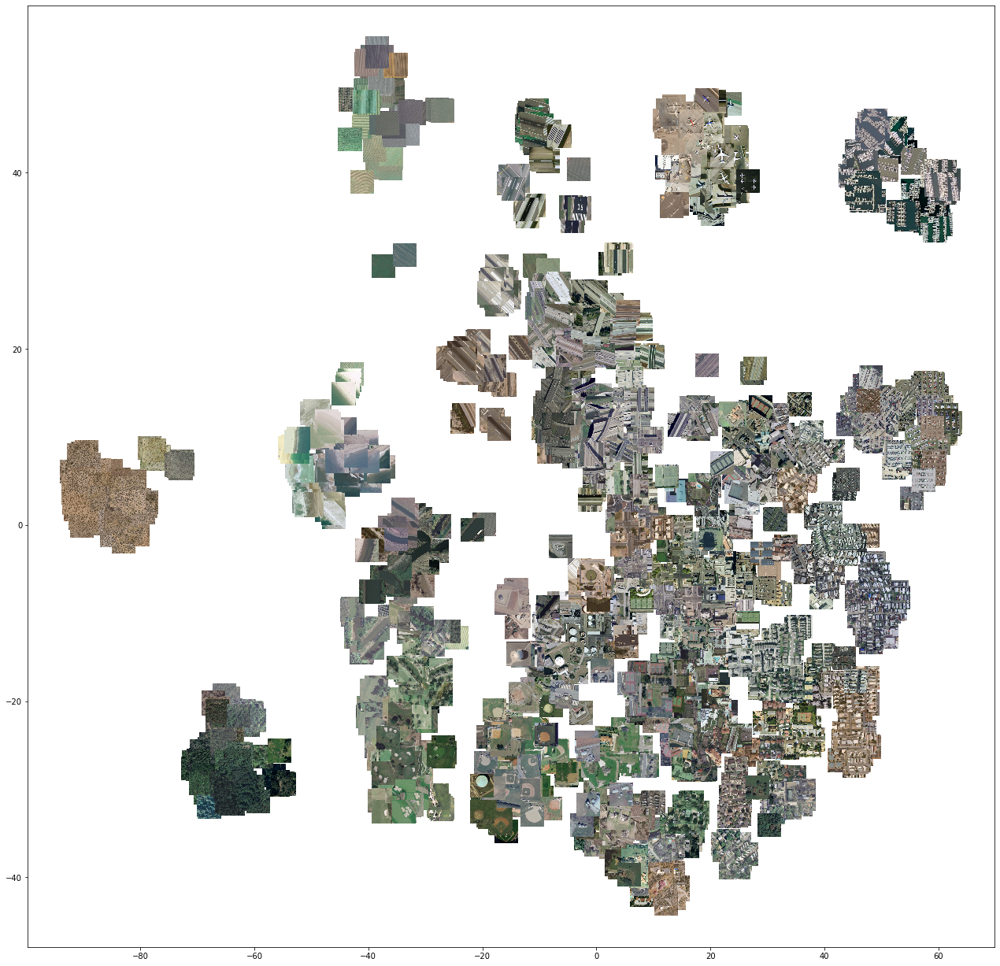

In [82]:
show_tsne(tsne_results[:, 0], tsne_results[:, 1], selected_filenames)

The show_tsne function piles images one on top of each other, making it harder to discern the patterns as the density of images is high. To help visualize the patterns better, we write another helper function tsne_to_grid_plotter_manual that spaces the images evenly

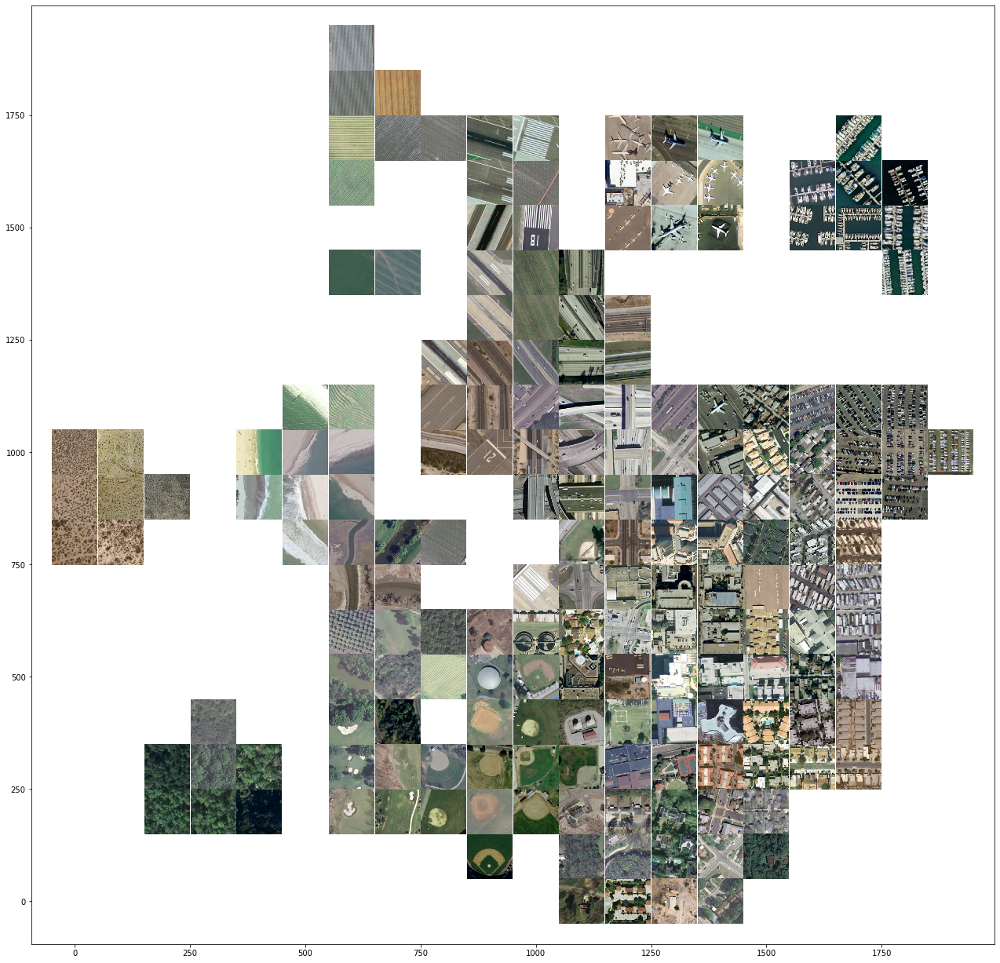

In [84]:
tsne_to_grid_plotter_manual(tsne_results[:, 0], tsne_results[:, 1],
                            selected_filenames)


### PCA

We will perform [Principal Component Analysis (PCA)](https://asaip.psu.edu/submitted-papers/2013/liii.-on-lines-and-planes-of-closest-fit-to-systems-of-points-in-space) over the features using `100` feature dimensions.


In [113]:
num_feature_dimensions = 100
pca = PCA(n_components=num_feature_dimensions)
pca.fit(feature_list)
feature_list_compressed = pca.transform(feature_list)

In [114]:
neighbors = NearestNeighbors(n_neighbors=5,
                             algorithm='brute',
                             metric='euclidean').fit(feature_list_compressed)
distances, indices = neighbors.kneighbors([feature_list_compressed[0]])

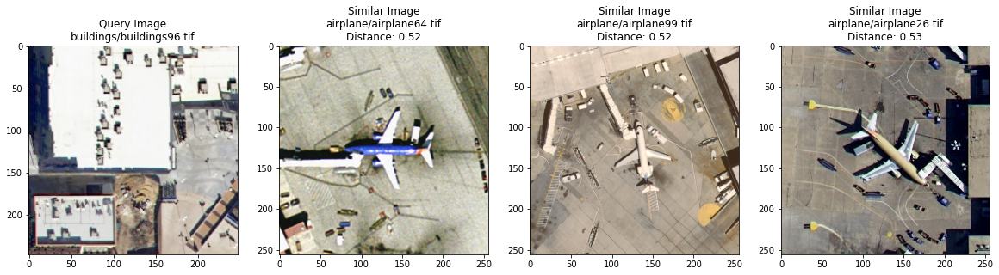

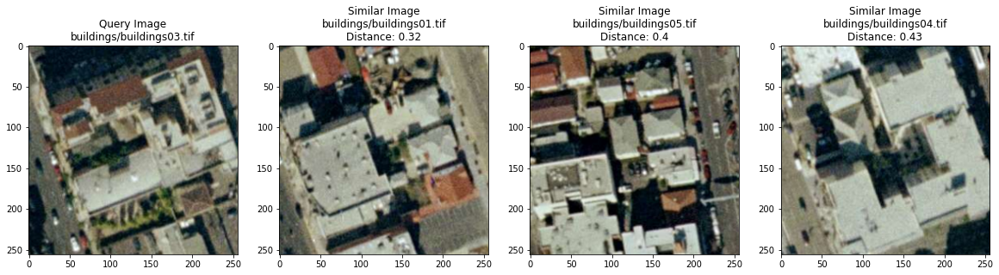

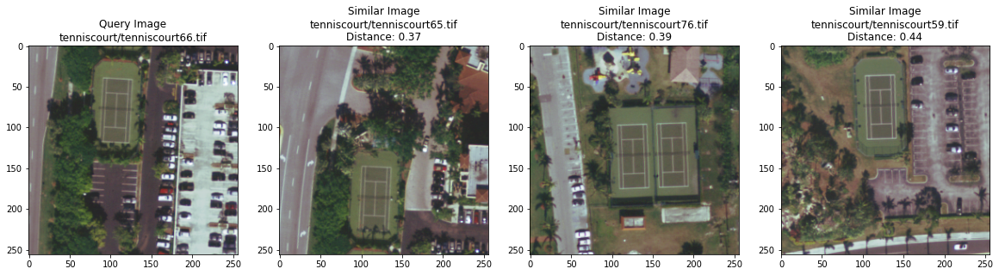

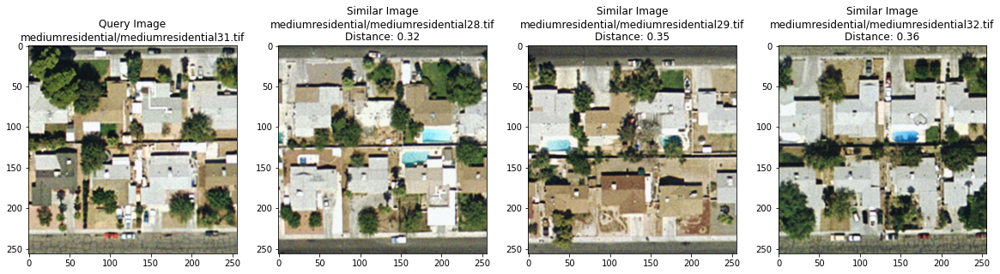

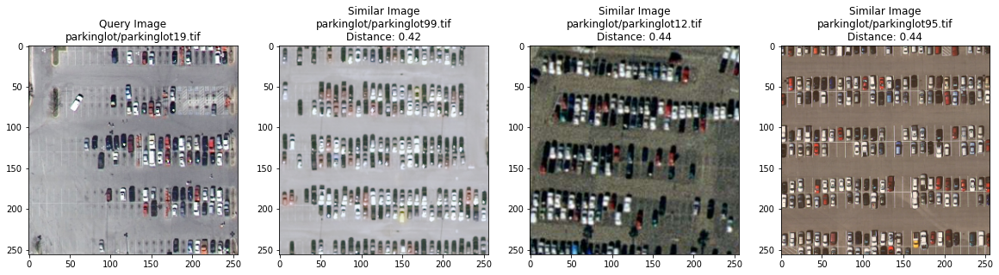

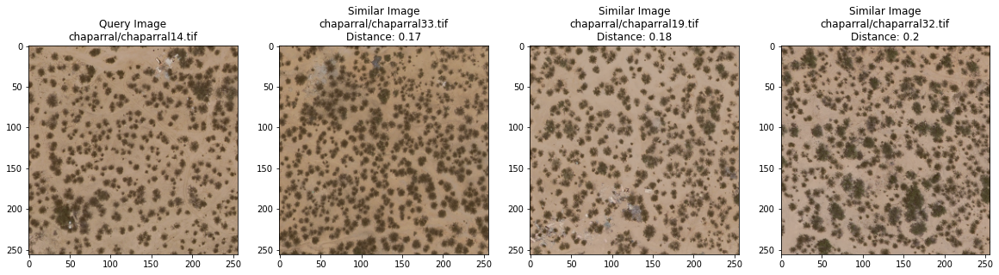

In [115]:
#Visualize some query images with their nearest neighbors
for i in range(6):
    random_image_index = random.randint(0, num_images)
    distances, indices = neighbors.kneighbors(
        [feature_list_compressed[random_image_index]])
    # Don't take the first closest image as it will be the same image
    similar_image_paths = [filenames[random_image_index]] + \
        [filenames[indices[0][i]] for i in range(1, 4)]
    plot_images(similar_image_paths, distances[0])

Again, for speed we pick a few thousand image samples.

In [116]:
selected_features = feature_list_compressed[:4000]
selected_class_ids = class_ids[:4000]
selected_filenames = filenames[:4000]

time_start = time.time()
tsne_results = TSNE(n_components=2, verbose=1, metric='euclidean').fit_transform(selected_features)
print('t-SNE done! Time elapsed: {} seconds'.format(time.time() - time_start))

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2100 samples in 0.021s...
[t-SNE] Computed neighbors for 2100 samples in 0.939s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2100
[t-SNE] Computed conditional probabilities for sample 2000 / 2100
[t-SNE] Computed conditional probabilities for sample 2100 / 2100
[t-SNE] Mean sigma: 0.198021
[t-SNE] KL divergence after 250 iterations with early exaggeration: 70.997528
[t-SNE] KL divergence after 1000 iterations: 0.902126
t-SNE done! Time elapsed: 17.1382954120636 seconds


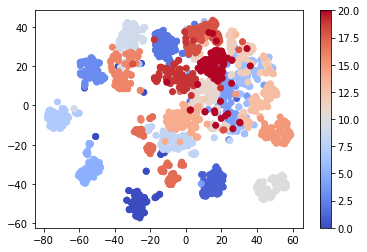

In [118]:
# Plot a scatter plot from the generated t-SNE results
color_map = plt.cm.get_cmap('coolwarm')
scatter_plot = plt.scatter(tsne_results[:, 0],
                           tsne_results[:, 1],
                           c=selected_class_ids,
                           cmap=color_map)
plt.colorbar(scatter_plot)
plt.show()

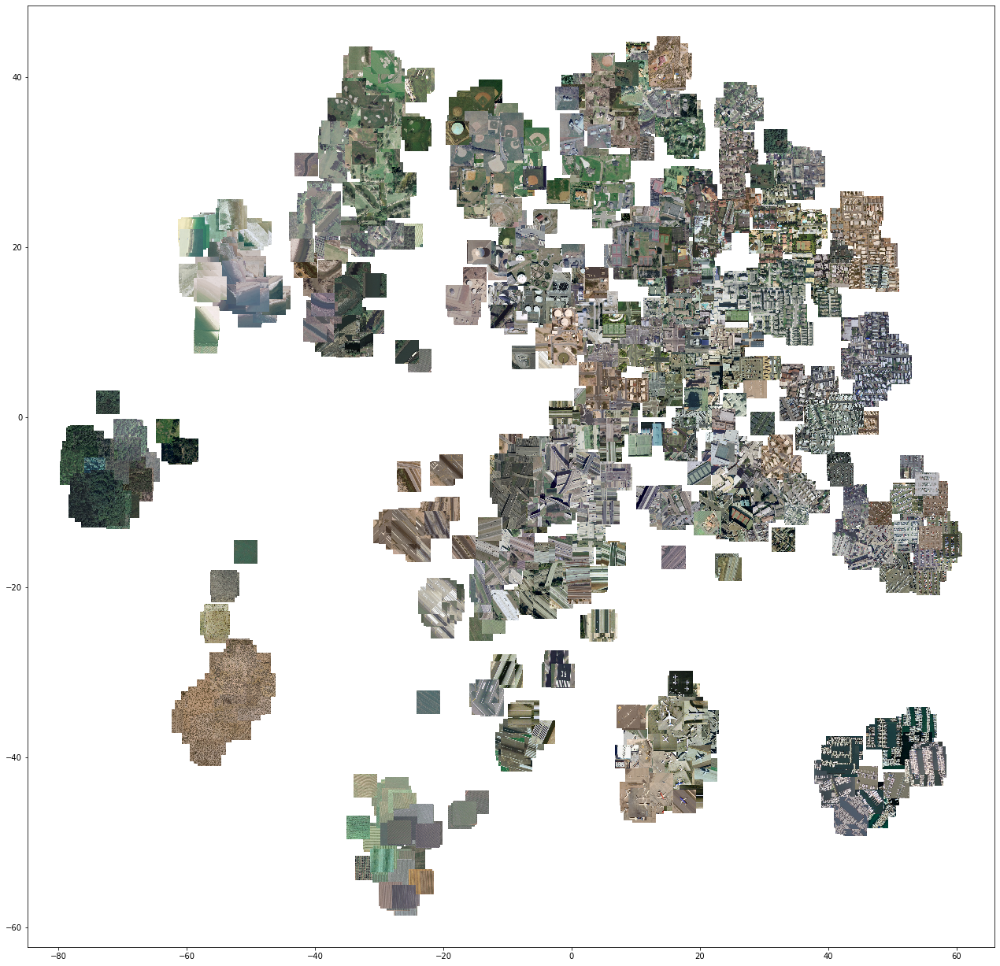

In [119]:
# Visualize the patterns in the images using t-SNE
show_tsne(tsne_results[:, 0], tsne_results[:, 1], selected_filenames)


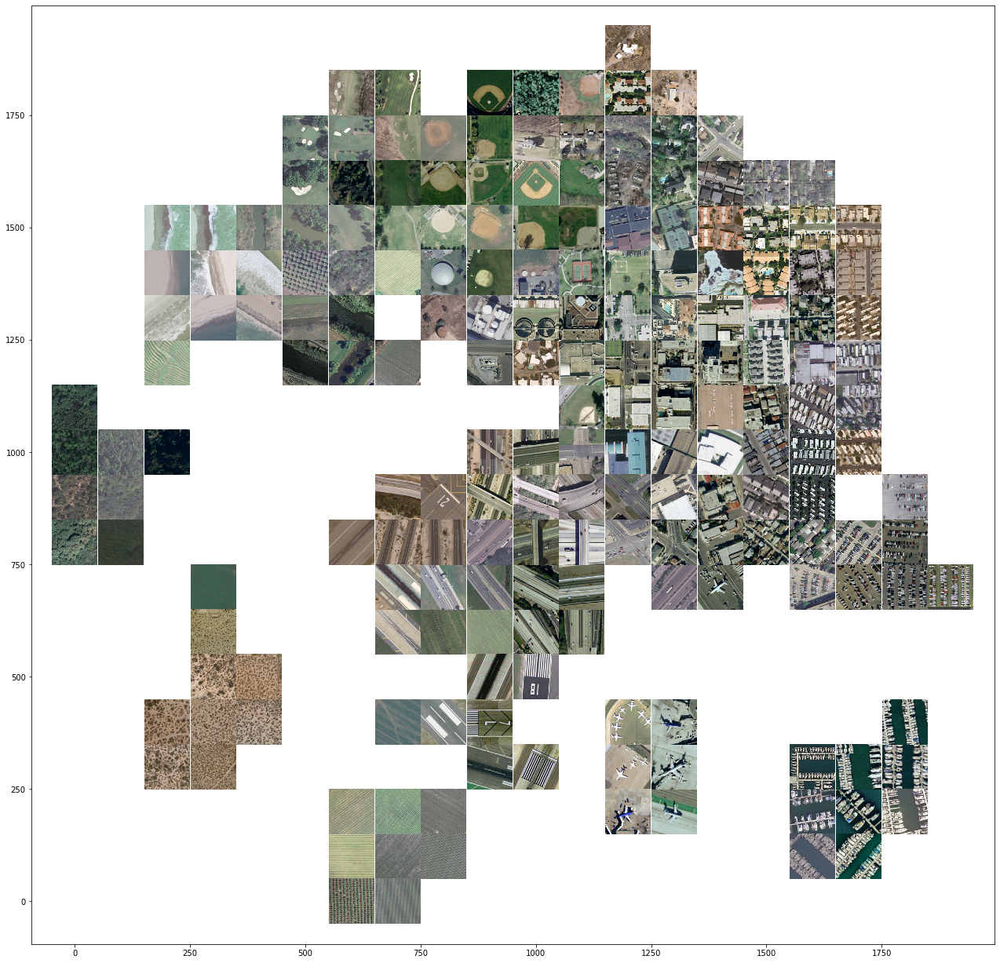

In [120]:
tsne_to_grid_plotter_manual(tsne_results[:, 0], tsne_results[:, 1], selected_filenames)